In [1]:
import pandas as pd
import pickle
import numpy as np
import json
from sklearn.preprocessing import LabelEncoder
from causallearn.search.ConstraintBased.PC import pc
from causallearn.utils.PCUtils.BackgroundKnowledge import BackgroundKnowledge
from causallearn.utils.cit import chisq, fisherz, gsq, kci, mv_fisherz
from causallearn.search.ScoreBased.GES import ges
from causallearn.score.LocalScoreFunction import local_score_BIC
from causallearn.utils.GraphUtils import GraphUtils
import io
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import pydot
import networkx as nx

from torch.utils.data import DataLoader
import torch
#Import for modification of ges 
from typing import Optional, List, Dict, Any
from numpy import ndarray
from causallearn.graph.GeneralGraph import GeneralGraph
from causallearn.graph.GraphNode import GraphNode
from causallearn.utils.DAG2CPDAG import dag2cpdag
from causallearn.utils.GESUtils import *
from causallearn.utils.PDAG2DAG import pdag2dag

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import KMeans

#import causalGenTool
from CFET.core.utils import show, handle_dcausation, graph2adj, check_cycles
from CFET.patch.causalLearnPatch import ges_updated
from CFET.core.generator import CausalGenerator, norm_col, KL
from CFET.core.discovery import Discoverer
from CFET.core.bias import Observer
from CFET.core.assessment import Assessor
from CFET.core.mwcf_train.trainer import Model
from CFET.core.mwcf_train.utils import MWCF_loss, dataset
from CFET.core.fitter import LinearSCM

/home/maxence/anaconda3/envs/causal-learn-test/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import torch
import torch.nn as nn

class SP_loss(nn.Module):
    """
        Deterministic Loss from the following paper:
        
        Russell, C; Kusner, M; Loftus, C; Silva, R; (2017) When Worlds Collide: 
        Integrating Different Counterfactual Assumptions in Fairness. 
        In: Guyon, I and Luxburg, UV and Bengio, S and Wallach, 
        H and Fergus, R and Vishwanathan, S and Garnett, R, 
        (eds.) Advances in Neural Information Processing Systems 30 (NIPS 2017).
        NIPS Proceedings: Long Beach, CA, USA.

    """
    
    def __init__(self, lam=1, eps=0.01):
        super(SP_loss, self).__init__()
        self.lam = lam
        self.eps = eps
    
    def forward(self, output0, target0, output1, target1):

        loss_first = nn.BCELoss()
        o_loss_first = loss_first(torch.cat((output0,output1)), torch.cat((target0,target1)))
        o_loss_second = torch.max((torch.linalg.norm(torch.mean(output0) - torch.mean(output1)) - self.eps), 0).values

        return (o_loss_first + (self.lam*o_loss_second))
    

def random_graph(n_var_lim = 15, coef_boundary = 7, no_child=True, no_parent = True):
    """
    """
    n_var = np.random.randint(4, n_var_lim)
    adj = np.zeros((n_var,n_var))

    for i in range(n_var):
        adj[i] = np.random.randint(-coef_boundary,coef_boundary, size=n_var)
        adj[i,i] = 0

    random_mask = np.random.randint(0,2, size=(n_var, n_var))
    adj = adj*random_mask
    
    if no_child:
        adj[:,0] = np.zeros(adj.shape[1])
    if no_parent:
        adj[-1,:] = np.zeros(adj.shape[0])
        
    for i in range(2,n_var+1):
        if check_cycles(adj[:i,:i])[0]:
            correction = np.zeros(adj[:i,:i].shape)
            correction[:(i-1),:(i-1)] = adj[:(i-1),:(i-1)]

            for j in range(i):

                correction[(i-1),j] = adj[(i-1),j]
                if check_cycles(correction)[0]:
                    correction[(i-1),j] = 0

                correction[j,(i-1)] = adj[j,(i-1)]
                if check_cycles(correction)[0]:
                    correction[j,(i-1)] = 0

            adj[:i,:i] = correction
        

                    
    return adj

## Creation of Synthetic Dataset

In [4]:
var_names = ['Sex', 'Age', 'Job', 'Credit_Amount','Housing',\
            'Wealth','Purpose','Duration','Credit_Score']
#Before -2 weight from x0 to x8
adj = np.array([[0, 0, -6, 0, 0, 1, 0, 0, 0], \
                [0, 0, -4, 1, 0, 1, 0, 0, -2], \
                [0, 0, 0, 0, 0, -5, 0, 0, 5],
                [0, 0, 0, 0, 0, 0, 0, 5, -5],
                [0, 0, 0, 0, 0, 1, 0, 0, 0],
                [0, 0, 0, 3, 0, 0, 0, -3, -4],
                [0, 0, 0, -7, 0, 0, 0, 0, 3],
                [0, 0, 0, 0, 0, 0, 0, 0, 1],
                [0, 0, 0, 0, 0, 0, 0, 0, 0]])

test = CausalGenerator(adj, var_names=None, size=100000, normalize=False)
test.graph_from_adjacency_matrix(directed=True)
test.generate_data()
#print(test.data.head())
#sample_ = pd.read_csv('./fairness/Fred/Test/synthetic_data.csv')
#sample_.drop('Unnamed: 0', axis='columns', inplace=True)
#test.data= sample_

#test.compute_CPDs()
#test.allEdgesCausalStrength()
#test.generate_counterfactual_worlds('x0')

#test.allEdgesCausalStrength_v2()
#test.isBayesianNetwork()
#test.save()
#assessor1 = Assessor(sensible_parameter='x0', output_variable='x8', data=test.data, bias=None)
#assessor1.compute_fairness(metrics=['statistical_parity'])

#test.show_graph()

,x0,x1,x2,x3,x4,x5,x6,x7,x8
0,1,1,0,0,0,0,0,0,0
1,1,1,0,1,0,0,1,0,0
2,1,1,0,1,0,1,1,1,0
3,0,0,1,0,0,0,1,0,1
4,1,1,0,1,1,1,1,1,0
...,...,...,...,...,...,...,...,...,...
99995,0,1,0,1,1,1,0,1,0
99996,1,0,0,1,1,1,1,1,0
99997,1,0,0,1,0,0,1,1,1
99998,1,0,0,0,1,1,1,0,0


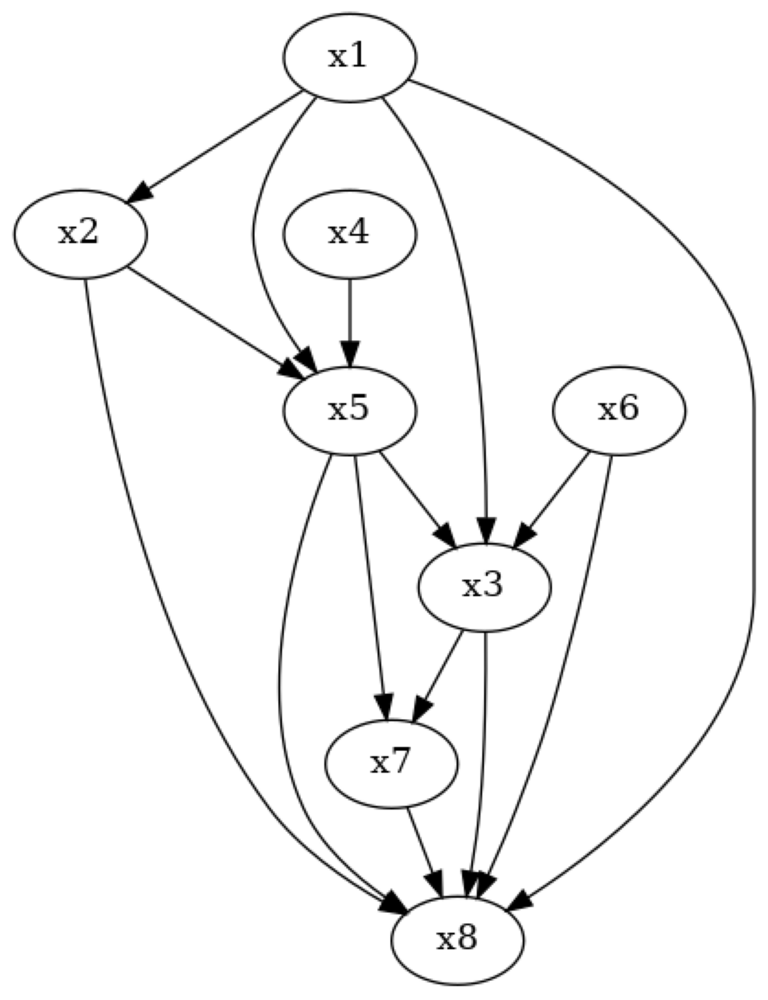

In [5]:
#World 2
var_names = ['Sex', 'Age', 'Job', 'Credit_Amount','Housing',\
            'Wealth','Purpose','Duration','Credit_Score']
#Before -2 weight from x0 to x8
adj = np.array([[0, 0, 0, 0, 0, 0, 0, 0, 0], \
                [0, 0, -4, 1, 0, 1, 0, 0, -2], \
                [0, 0, 0, 0, 0, -5, 0, 0, 5],
                [0, 0, 0, 0, 0, 0, 0, 5, -5],
                [0, 0, 0, 0, 0, 1, 0, 0, 0],
                [0, 0, 0, 3, 0, 0, 0, -3, -4],
                [0, 0, 0, -7, 0, 0, 0, 0, 3],
                [0, 0, 0, 0, 0, 0, 0, 0, 1],
                [0, 0, 0, 0, 0, 0, 0, 0, 0]])

test2 = CausalGenerator(adj, var_names=None, size=100000, normalize=False)
test2.graph_from_adjacency_matrix(directed=True)
test2.generate_data()
#print(test.data.head())
#sample_ = pd.read_csv('./fairness/Fred/Test/synthetic_data.csv')
#sample_.drop('Unnamed: 0', axis='columns', inplace=True)
#test.data= sample_
#test.compute_CPDs()
#test.allEdgesCausalStrength()
test2.generate_counterfactual_worlds('x0')
#test.allEdgesCausalStrength_v2()
#test.isBayesianNetwork()
#test.save()
#assessor1 = Assessor(sensible_parameter='x0', output_variable='x8', data=test.data, bias=None)
#assessor1.compute_fairness(metrics=['statistical_parity'])
test2.show_graph()

### (Optionnal), compute Stability Score

In [ ]:
for i in range(50):
    observer = Observer(test.data, 'x0')
    sample = observer.observe(bias=None, n_data=10000)
    alg ='pc'
    pc_param = {'alpha' : [0.05], 'indep_test':[gsq]}
    discoverer2 = Discoverer()
    discoverer2.grid_search(sample.to_numpy(), alg, pc_param, test.graph)
    
true_graph = discoverer2.grid_search_results()
for i in range(len(discoverer2.discovered_graphs_pyd)):
    discoverer2.discovered_graphs_pyd[-1].write_png('./outputs/stability2/graph'+str(i)+'.png')

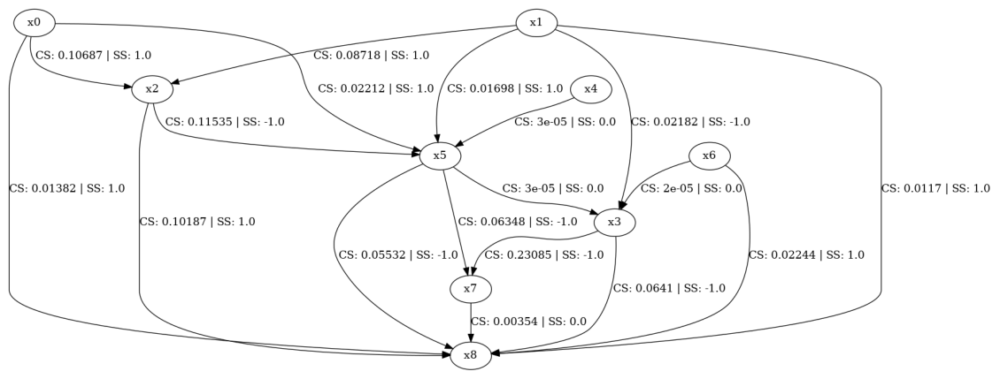

In [160]:
show(discoverer2.gs_true_graph)

## Fetch sample and add bias to it

In [5]:
probs = {
    'keys':['x0','x8'],
    'values': (1,1),
    'prob': 0.7
}
#probs2 = {
    #'keys':['x0','x1','x2','x8'],
    #'values': (1,1,1,1),
    #'prob': 0.7
#}
#conds = [probs, probs2]
conds = [probs]
observer = Observer(test.data, 'x0')
sample = observer.observe(bias=conds, n_data=10000, debug=False)


0.7001180637544274


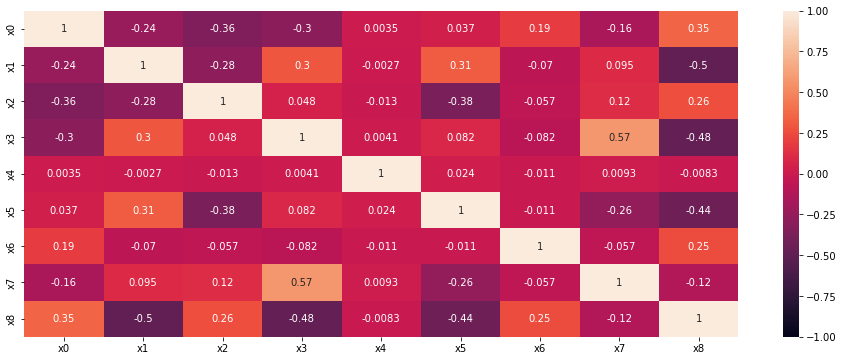

In [136]:
import seaborn as sns
plt.figure(figsize=(16, 6))
corr = sample.corr()
heatmap = sns.heatmap(corr, vmin=-1, vmax=1, annot=True)

## Discovery Part

Current parameters used:  {'alpha': 0.05, 'indep_test': <function gsq at 0x7f0a3f973d30>}


Depth=6, working on node 8: 100%|██████████| 9/9 [00:00<00:00, 353.84it/s] 


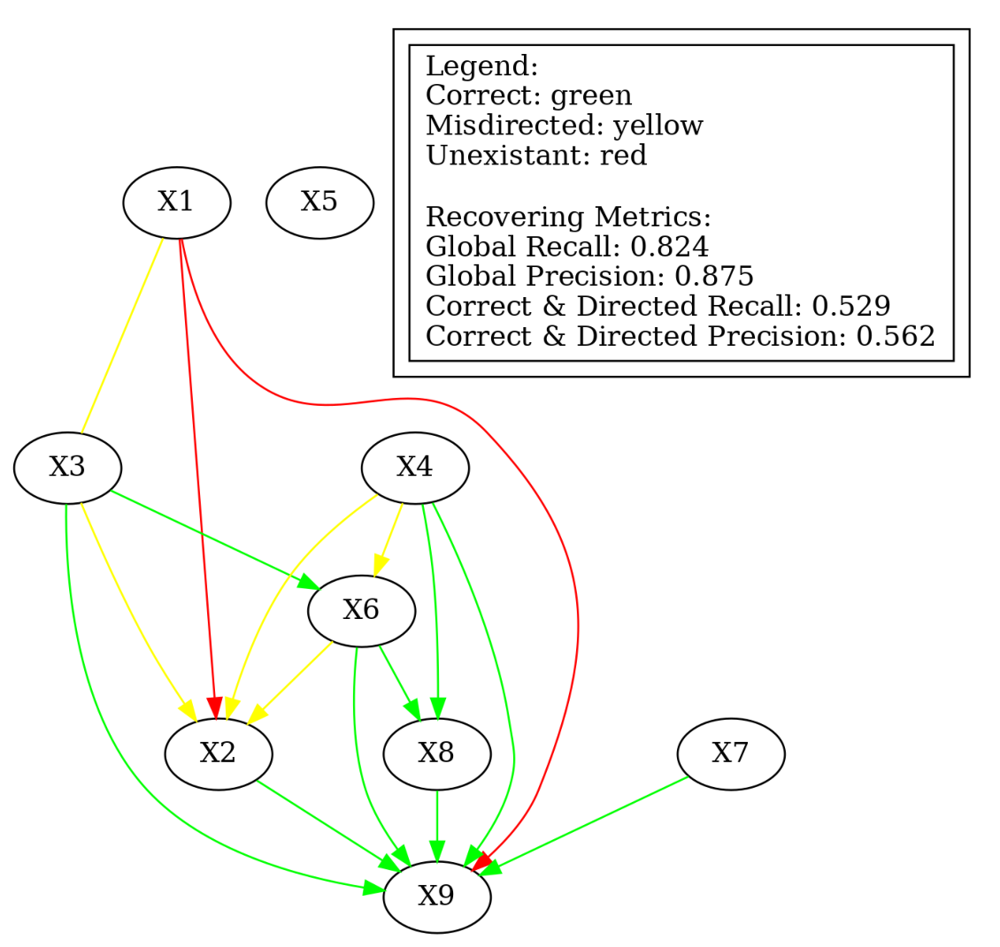

In [8]:
alg ='pc'
pc_param = {'alpha' : [0.05], 'indep_test':[gsq]}
discoverer2 = Discoverer()
discoverer2.grid_search(sample.to_numpy(), alg, pc_param, test.graph)
#alg ='ges'
#ges_param = {'score_func' : ['local_score_BIC','local_score_BDeu'], 'maxP' : [None]}
#discoverer2.grid_search(test.data.to_numpy(), alg, ges_param, test.graph)
true_graph = discoverer2.grid_search_results()
show(discoverer2.discovered_graphs_pyd[0])

In [ ]:
#alg ='pc'
#pc_param = {'alpha' : [0.05], 'indep_test':[gsq]}
discoverer2 = Discoverer()
#discoverer2.grid_search(sample.to_numpy(), alg, pc_param, test.graph)
alg ='ges'
ges_param = {'score_func' : ['local_score_BIC'], 'maxP' : [None]}
discoverer2.grid_search(sample.to_numpy(), alg, ges_param, test.graph)
true_graph = discoverer2.grid_search_results()
show(discoverer2.discovered_graphs_pyd[-1])

## Prediction part

In [70]:
#Init
from imblearn.under_sampling import RandomUnderSampler
X = sample.iloc[:,:-1]
y = sample['x8']

under_sampler = RandomUnderSampler(random_state=42)
X_res, y_res = under_sampler.fit_resample(X, y)

In [73]:
X_pc1 = X_res[['x4','x6']]
X_pc2 = X_res[['x5','x4','x6']]
X_pc3 = X_res[['x7','x4','x5']]
X_pc4 = X_res[['x2','x1','x7']]
X_pc5 = X_res[['x4','x6','x1']]
#X_pc2 = X_res[['x6','x4', 'x5']]
X_ges = X_res[['x2']]

datasets = [X_pc1, X_pc2, X_pc3, X_pc4, X_pc5, X_ges]

In [74]:
assessor1 = Assessor('x0', 'x8', test.data, bias= conds)
scores_real = assessor1.compute_fairness(['statistical_parity','KL_fairness'], ['x1','x2','x3','x4','x5','x6','x7'])
print("REAL WORLD: ", scores_real)
#observer.describe(sample, CSP=conds)
for idx, dataset in enumerate(datasets):
    assessor2 = Assessor('x0', 'x8', sample, bias= conds)
    print("[{}] EXTRACTED WORLD: ".format(idx),assessor2.compute_fairness(['statistical_parity','KL_fairness'], list(dataset.columns)))

REAL WORLD:  {'statistical_parity': -0.19282442950217343, 'KL_fairness': 1.1338667109381069}
[0] EXTRACTED WORLD:  {'statistical_parity': 0.3606836578408224, 'KL_fairness': 0.2877663037884786}
[1] EXTRACTED WORLD:  {'statistical_parity': 0.3606836578408224, 'KL_fairness': 0.35159849682496325}
[2] EXTRACTED WORLD:  {'statistical_parity': 0.3606836578408224, 'KL_fairness': 0.3491221040176634}
[3] EXTRACTED WORLD:  {'statistical_parity': 0.3606836578408224, 'KL_fairness': 1.1397099892999998}
[4] EXTRACTED WORLD:  {'statistical_parity': 0.3606836578408224, 'KL_fairness': 0.3226369534061669}
[5] EXTRACTED WORLD:  {'statistical_parity': 0.3606836578408224, 'KL_fairness': 1.1124278761144868}


In [75]:
from sklearn.model_selection import StratifiedKFold
from sklearn.utils import resample
from tqdm import tqdm
#Selection

skf = StratifiedKFold(n_splits=10)

probs = {
    'keys':['x0','Output'],
    'values': (1,1),
    'prob': 0.7
}

store = []
#probs2 = {
    #'keys':['x0','x1','x2','x8'],
    #'values': (1,1,1,1),
    #'prob': 0.7
#}
#conds = [probs, probs2]
conds = [probs]

metrics = ['statistical_parity','CSP', 'overall_accuracy', 'KL_fairness', 'accuracy']
records  = {key: []  for key in metrics}
method = {}

for idx, dataset in enumerate(datasets):
    
    bias = []
    keys = ['x0'] + list(dataset.columns) + ['Output']
    values_ = list(itertools.product(*[(0, 1)] * (len(keys)-2)))
    values = values = [(1,) + v + (1,) for v in values_]
    for v in values:
        bias.append({'keys' : keys, 'values' : v})

    records  = {key: []  for key in metrics}

    for train_index, test_index in skf.split(dataset, y_res):
        X_train = dataset.loc[train_index,:]
        y_train = y_res.loc[train_index]
        X_test = dataset.loc[test_index,:]
        y_test = y_res.loc[test_index]
        clf = LogisticRegression(random_state=0).fit(X_train, y_train)

        for i in tqdm(range(1000)):
            
            X_val, y_val = resample(X_test, y_test, random_state=i)
            outputs = clf.predict(X_val)
            output_df = X.iloc[X_val.index].copy()
            output_df['Output'] = outputs
            output_df['x8'] = y.iloc[y_val.index].copy()
            store.append(output_df)
            assessor = Assessor(sensible_parameter='x0', output_variable='Output', data=output_df, bias = bias)
            record = assessor.compute_fairness(metrics=metrics, extracted_var=list(dataset.columns))

            for key in list(record.keys()):
                records[key].append(record[key])
                
    method[idx] = records

100%|██████████| 1000/1000 [00:48<00:00, 20.57it/s]


In [62]:
def compare_boxplot(record_real, records_method):

    assert isinstance(records_method, dict), 'expected dict of records, one for each method'
    assert isinstance(record_real, dict), 'expected record in dict format'

    for key in records_method[0]:
        if key == 'CSP':
            continue
        _, ax = plt.subplots(figsize=(10,10))
        boxplot_stat = {key+'_meth{}'.format(idx): records_method[idx][key] for idx in list(records_method.keys())}
        if key in record_real: plt.plot([record_real[key] for i in range(len(records_method)+2)], color='red')
        pd.DataFrame.from_dict(boxplot_stat).boxplot(ax=ax)

### Test distance between Counterfactuals

In [ ]:
from tqdm import tqdm
probs = {
    'keys':['x0','x8'],
    'values': (1,1),
    'prob': 0.7
}
alg ='pc'
pc_param = {'alpha' : [0.05], 'indep_test':[gsq]}
conds = [probs]
results = {}
for i in tqdm(range(10)):
    observer = Observer(test.data, 'x0')
    sample = observer.observe(bias=conds, n_data=10000, debug=False)

    
    discoverer = Discoverer()
    discoverer.grid_search(sample.to_numpy(), alg, pc_param, test.graph)
    true_graph = discoverer2.grid_search_results()
    adj_  = graph2adj(discoverer.discovered_graphs[-1].graph)
    scm_fitter = LinearSCM(adj_)
    scm = scm_fitter.fit(sample)
    scms = [test.adjency_matrix, scm]

    for idx, scm in enumerate(scms):

        new_gen = CausalGenerator(adjency_matrix=scm, normalize=True)
        new_gen.graph_from_adjacency_matrix(directed=True)
        new_gen.generate_data(store=True)
    
        new_gen.noise = test.noise[:,sample.index]
        sample = sample.reset_index(drop=True)
        new_gen.data = sample
        new_gen.generate_counterfactual_worlds('x0')

        p = []
        q = []

        for idx_ in test.counterfactual_world_0.value_counts(normalize=True).index:
            if idx_ in new_gen.counterfactual_world_0.value_counts().index:
                q.append(new_gen.counterfactual_world_0.value_counts(normalize=True)[idx_])
                p.append(test.counterfactual_world_0.value_counts(normalize=True)[idx_])
                
        if idx in list(results.keys()):
            results[idx].append(KL(p,q))
        else: 
            results[idx] = [KL(p,q)]

In [54]:
from tqdm import tqdm
probs = {
    'keys':['x0','x8'],
    'values': (1,1),
    'prob': 0.7
}
alg ='pc'
pc_param = {'alpha' : [0.05], 'indep_test':[gsq]}
conds = [probs]
results = {}

observer = Observer(test.data, 'x0')
sample = observer.observe(bias=conds, n_data=10000, debug=False)

    
discoverer = Discoverer()
discoverer.grid_search(sample.to_numpy(), alg, pc_param, test.graph)
true_graph = discoverer.grid_search_results()
adj_  = graph2adj(discoverer.discovered_graphs[-1].graph)
#/!\ True adj 
#adj_ = (test.adjency_matrix != 0).astype(float)
adj_list = handle_dcausation(adj_)
adj_list = [adj for adj in adj_list if not check_cycles(adj, True)]
scm_fitter = [LinearSCM(adj) for adj in adj_list]
scms = [fitter.fit(sample) for fitter in scm_fitter]
counterfactuals = []
for idx, scm in enumerate(scms):
    #Empty
    empty = pd.DataFrame(0, index=range(len(sample)), columns=sample.columns)
    new_gen = CausalGenerator(adjency_matrix=scm, normalize=True)
    new_gen.graph_from_adjacency_matrix(directed=True)
    print("Init Data: ",str(idx))
    new_gen.generate_data(store=True)
    #ynew_gen.noise = scm_fitter[idx].noises[:,sample.index]
    sample = sample.reset_index(drop=True)
    new_gen.noise = scm_fitter[idx].noises[:,sample.index]
    new_gen.data = sample
    print("CF Data: ",str(idx))
    new_gen.generate_counterfactual_worlds('x0')
    #counterfactual = pd.concat([new_gen.counterfactual_world_1.iloc[sample[sample['x0'] == 0].index], new_gen.counterfactual_world_0.iloc[sample[sample['x0'] == 1].index]], axis=0)
    empty.update(new_gen.counterfactual_world_1.iloc[sample[sample['x0'] == 0].index])
    empty.update(new_gen.counterfactual_world_0.iloc[sample[sample['x0'] == 1].index])
    counterfactuals.append(empty)

NameError: name 'test' is not defined

In [11]:
#Train test split
X_train, X_test, y_train, y_test= train_test_split(sample.iloc[:,:-1], sample.iloc[:,-1], test_size=0.2)
counterfactuals_train = [counterfactual.iloc[X_train.index] for counterfactual in counterfactuals]
counterfactuals_test = [counterfactual.iloc[X_test.index] for counterfactual in counterfactuals]

#Datasets
trainset = dataset(X_train.values, y_train.values, counterfactuals_train)
testset = dataset(X_test.values, y_test.values, counterfactuals_test)

#DataLoader
trainloader = DataLoader(trainset, batch_size=128, shuffle=False)
testloader = DataLoader(testset, batch_size=128, shuffle=False)

In [120]:
#training loop
epochs = 200
model = Model(8)
optimizer = torch.optim.SGD(model.parameters(), lr=0.1, momentum=5e-4)
loss = MWCF_loss(lam=2.8, eps=0.1)
model.train()

for i in range(epochs):
    trainloss_total = []
    valloss_total = []
    model.train(True)
    for j, (x_train, y_train, cf_train) in enumerate(trainloader):
        output = model(x_train)
        cf_output = torch.hstack([model(counter_data) for counter_data in cf_train])
        error = loss(output, y_train, cf_output)
        optimizer.zero_grad()
        error.backward()
        optimizer.step()
        trainloss_total.append(error)

    if (i % 100) == 0:
        model.train(False)
        for k, (x_test, y_test, cf_test) in enumerate(testloader):
            out_test = model(x_test)
            cf_out_test = torch.hstack([model(counter_data_test) for counter_data_test in cf_test])
            error = loss(out_test, y_test, cf_out_test)
            valloss_total.append(error)

        print('Epoch: {} -- Training Loss: '.format(i), sum(trainloss_total)/len(trainloss_total),\
            " Val Loss: ", sum(valloss_total)/len(valloss_total))
        

Epoch: 0 -- Training Loss:  tensor(0.7865, grad_fn=<DivBackward0>)  Val Loss:  tensor(0.6462, grad_fn=<DivBackward0>)
Epoch: 100 -- Training Loss:  tensor(0.4856, grad_fn=<DivBackward0>)  Val Loss:  tensor(0.4770, grad_fn=<DivBackward0>)


In [122]:
model.eval_cf(cf0, cf1)
model.evalmodified(testloader)

Counterfactuall Accuracy: tensor([1.])
F1 Score: tensor([0.7443]) -- Precision: tensor([0.8340]) -- Recall: tensor([0.6720])


(tensor([0.7443]), tensor([0.8340]), tensor([0.6720]))

In [13]:
out_0 = model(counterfactual_0)
out_1 = model(counterfactual_1)
h1 = out_0.histc(bins=50)
h2 = out_1.histc(bins=50)

In [14]:
KL(out_0.detach().numpy(),out_1.detach().numpy())

array([-50.43655], dtype=float32)

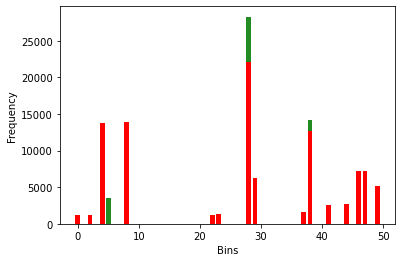

In [15]:
plt.bar(range(len(h1)),h1, align='center', color=['forestgreen'])
plt.bar(range(len(h1)),h2, align='center', color=['red'])
plt.xlabel('Bins')
plt.ylabel('Frequency')
plt.show()


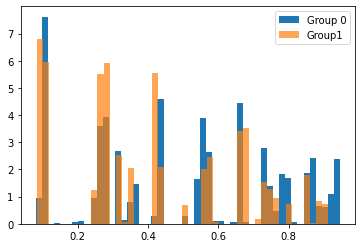

In [335]:
plt.hist(out_0.detach().numpy(), bins=50, density=True, alpha = 1, label='Group 0')
plt.hist(out_1.detach().numpy(), bins=50, density=True, alpha = 0.7, label='Group1')
plt.legend(loc='upper right')
plt.show()

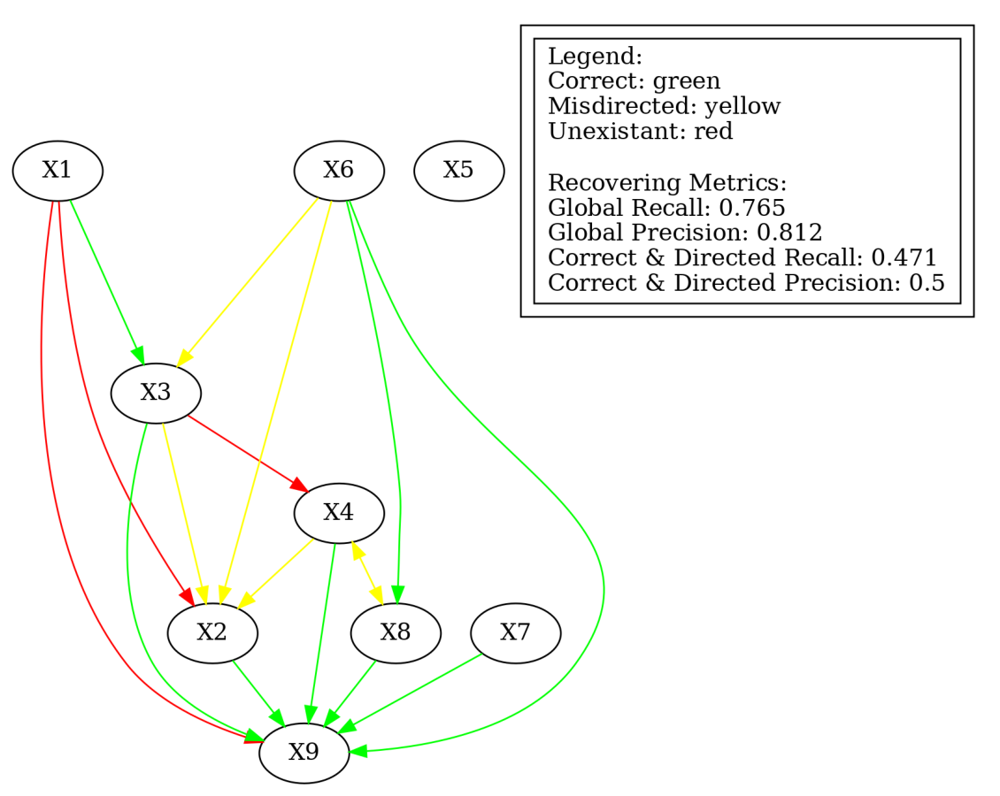

In [9]:
show(discoverer.discovered_graphs_pyd[0])

In [13]:
sam_ = torch.from_numpy(test2.data.sample(10000).values).float()
sam = sam_[:,:-1]
sam.shape

torch.Size([10000, 8])

In [14]:
#training loop for curve plotting
import torch

cf_accus = []
f1s = []
precisions = []
recalls = []
lambdas = np.arange(start=0,stop=7, step=0.2)
preds_world_2 = []

fouts_0 = []
fouts_1 = []

for lam in tqdm(lambdas):

    epochs = 200
    model = Model(8)
    optimizer = torch.optim.SGD(model.parameters(), lr=0.1, momentum=5e-4)
    loss = MWCF_loss(lam=lam, eps=0.1)
    model.train()
    for i in range(epochs):
        trainloss_total = []
        valloss_total = []
        model.train(True)
        for j, (x_train, y_train, cf_train) in enumerate(trainloader):
            output = model(x_train)
            cf_output = torch.hstack([model(counter_data) for counter_data in cf_train])
            error = loss(output, y_train, cf_output)
            optimizer.zero_grad()
            error.backward()
            optimizer.step()
            trainloss_total.append(error)

        if (i % 100) == 0:
            model.train(False)
            for k, (x_test, y_test, cf_test) in enumerate(testloader):
                out_test = model(x_test)
                cf_out_test = torch.hstack([model(counter_data_test) for counter_data_test in cf_test])
                error = loss(out_test, y_test, cf_out_test)
                valloss_total.append(error)

    cf0 = torch.from_numpy(test.counterfactual_world_0.values[:,:-1]).float()
    cf1 = torch.from_numpy(test.counterfactual_world_1.values[:,:-1]).float()
    gp0 = test.data.values[:,:-1][test.data.values[:,0] == 0]
    gp1 = test.data.values[:,:-1][test.data.values[:,0] == 1]
    
    f1, precision, recall = model.evalmodified(testloader)
    cf_accu = model.eval_cf(cf0,cf1)
    preds_sam = model(sam)
    preds_world_2.append(preds_sam)

    fouts_0.append(model(torch.from_numpy(gp0).float()))
    fouts_1.append(model(torch.from_numpy(gp1).float()))

    cf_accus.append(cf_accu)
    f1s.append(f1)
    precisions.append(precision)
    recalls.append(recall)



100%|██████████| 35/35 [23:07<00:00, 39.65s/it]


[tensor([0.7321]), tensor([0.7843]), tensor([0.7817]), tensor([0.7839]), tensor([0.7806]), tensor([0.7769]), tensor([0.7769]), tensor([0.7728]), tensor([0.7794]), tensor([0.7794]), tensor([0.7757]), tensor([0.7794]), tensor([0.7728]), tensor([0.7806]), tensor([0.7815]), tensor([0.7728]), tensor([0.7728]), tensor([0.7728]), tensor([0.7728]), tensor([0.7728]), tensor([0.7728]), tensor([0.7728]), tensor([0.7728]), tensor([0.7728]), tensor([0.7746]), tensor([0.7728]), tensor([0.7728]), tensor([0.7728]), tensor([0.7734]), tensor([0.7728]), tensor([0.7728]), tensor([0.7728]), tensor([0.7728]), tensor([0.7728]), tensor([0.7728])]


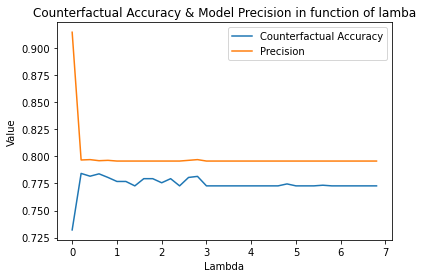

In [15]:
print(cf_accus)
plt.plot(lambdas[:len(cf_accus)],[cf_accu.numpy() for cf_accu in cf_accus], label='Counterfactual Accuracy')
plt.plot(lambdas[:len(cf_accus)],[precision.numpy() for precision in precisions], label='Precision')
plt.title('Counterfactual Accuracy & Model Precision in function of lamba')
plt.xlabel('Lambda')
plt.ylabel('Value')
plt.legend(loc='upper right')
plt.show()

In [6]:
with open("./saved_results/cf_accu8.txt", "w") as f:
    for s in cf_accus:
        f.write(str(s.numpy()[0]) +"\n")
    
with open("./saved_results/precs8.txt", "w") as f:
    for s in precisions:
        f.write(str(s.numpy()[0]) +"\n")

In [158]:
precs_read = []
cf_accus_read = []

for i in range(0,100):
    with open("./script_results/precs"+str(i)+".txt", 'r') as f:
        score = [line.rstrip('\n') for line in f]
    precs_read.append(score)

    with open("./script_results/cf_accus"+str(i)+".txt", 'r') as f2:
        score = [line.rstrip('\n') for line in f2]
    cf_accus_read.append(score)

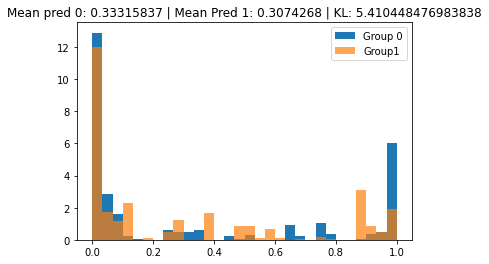

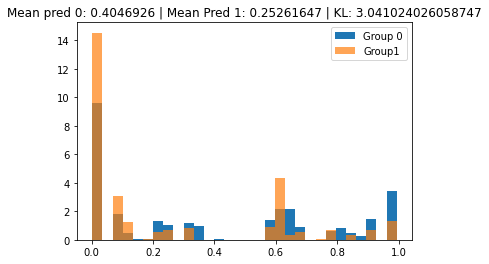

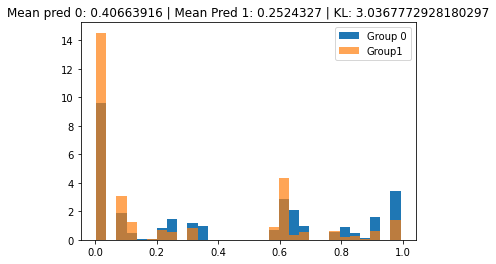

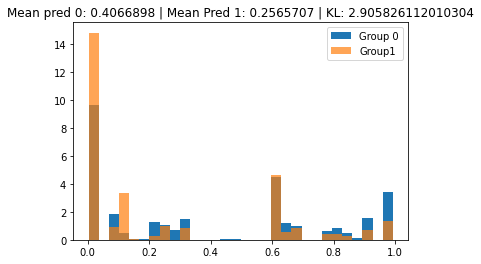

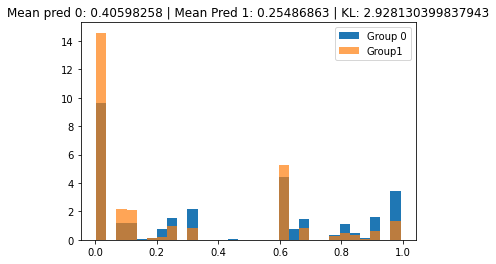

...

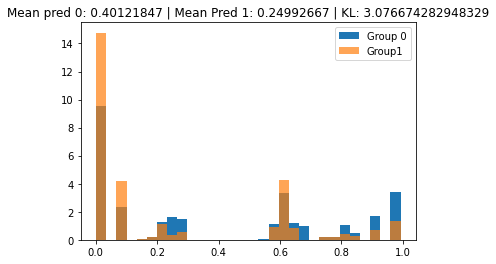

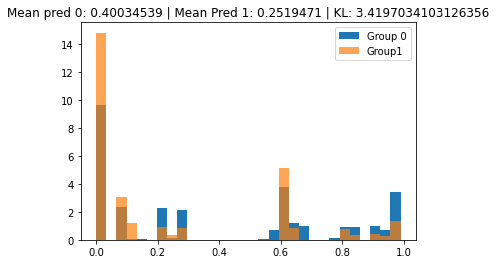

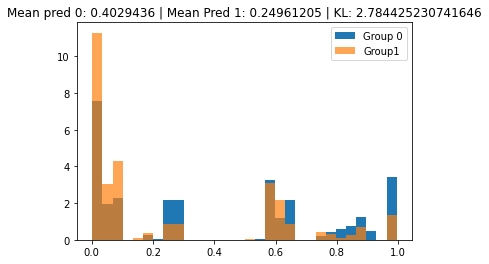

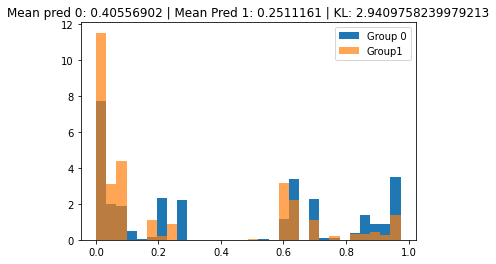

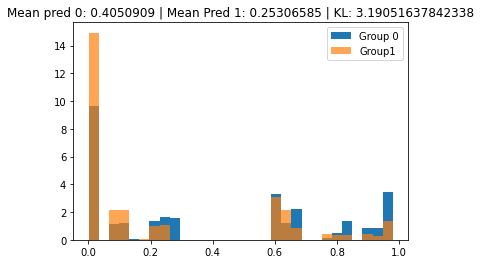

In [18]:
KLs = []
for o0, o1 in zip(fouts_0, fouts_1):
    v0 = plt.hist(o0.detach().numpy(), bins=30, alpha = 1, label='Group 0', weights = np.zeros_like(o0.detach().numpy()) + 1. / len(o0.detach().numpy()), density=True)
    v1 = plt.hist(o1.detach().numpy(), bins=v0[1], alpha = 0.7, label='Group1', weights = np.zeros_like(o1.detach().numpy()) + 1. / len(o1.detach().numpy()), density=True)
    v0[0][np.where(v0[0] == 0)] = 1
    v1[0][np.where(v1[0] == 0)] = 1
    KLs.append(KL(v0[0]/sum(v0[0]),v1[1]/sum(v1[0])))
    plt.legend(loc='upper right')
    plt.title('Mean pred 0: ' + str(torch.mean(o0).detach().numpy()) + ' | Mean Pred 1: ' + str(torch.mean(o1).detach().numpy()) + ' | KL: ' + str(KL(v0[0]/sum(v0[0]),v1[1]/sum(v1[0]))))
    plt.show()

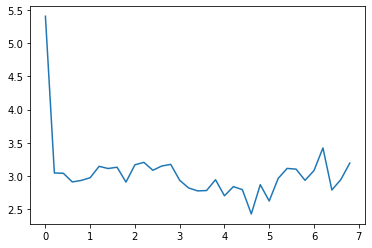

In [19]:
plt.plot(lambdas[:len(cf_accus)],KLs, label='KLs')

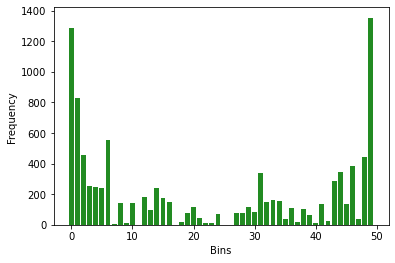

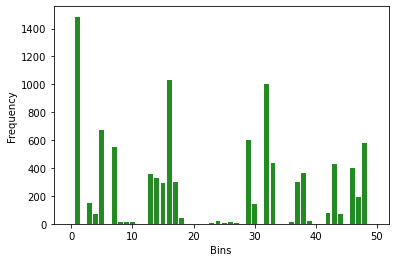

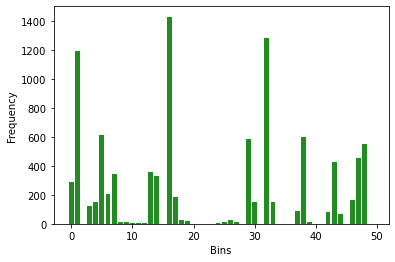

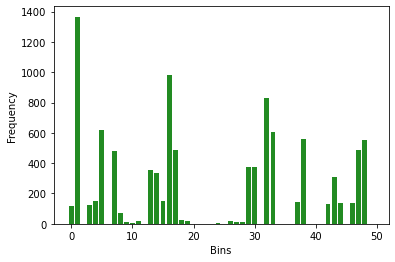

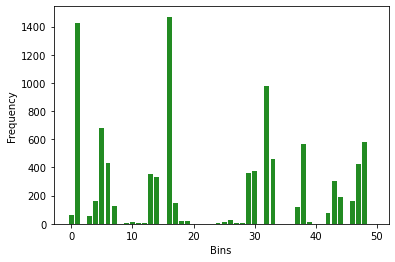

...

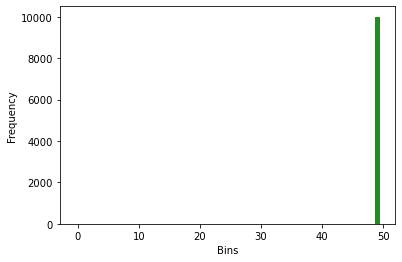

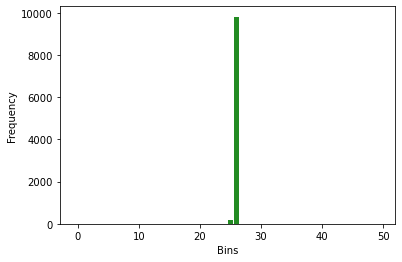

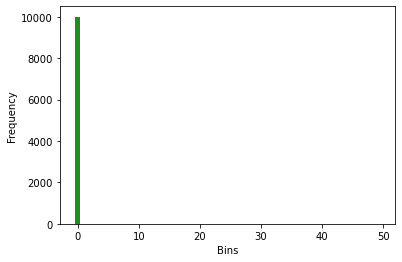

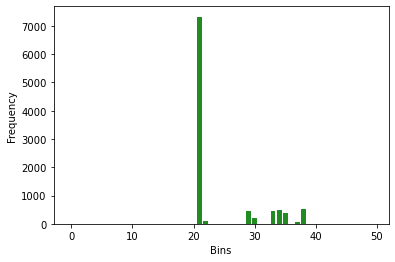

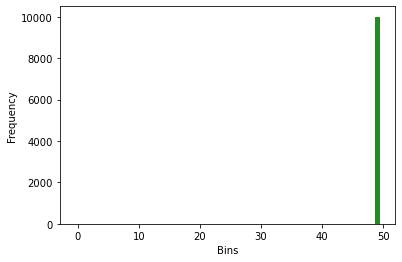

In [59]:
for i in range(len(preds_world_2)):
    hist = torch.histc(preds_world_2[i], bins=50, min=0, max=1, out=None)

    bins = 50
    x = range(bins)
    plt.bar(x, hist, align='center', color=['forestgreen'])
    plt.xlabel('Bins')
    plt.ylabel('Frequency')
    plt.show()

In [205]:
import plotly.graph_objs as go

lambdas = np.arange(start=0,stop=7, step=0.2).tolist()
precs_mean = np.nanmean(np.array(precs_read, dtype=float), axis=0)
precs_std = np.nanstd(np.array(precs_read, dtype=float), axis=0)
precs_max = (precs_mean + precs_std).tolist()
precs_min = (precs_mean - precs_std).tolist()

cf_mean_ = np.nanmean(np.array(cf_accus_read, dtype=float), axis=0)
cf_std_ = np.nanstd(np.array(cf_accus_read, dtype=float), axis=0)
cf_max_ = (cf_mean_ + cf_std_).tolist()
cf_min_ = (cf_mean_ - cf_std_).tolist()

fig = go.Figure([
    go.Scatter(
        x=lambdas,
        y=cf_mean_,
        line=dict(color='rgb(100,0,0)'),
        mode='lines',
        name=' Mean Counterfactual Accuracy',
    ),
    go.Scatter(
        x=lambdas+lambdas[::-1], # x, then x reversed
        y=cf_max_ + cf_min_[::-1], # upper, then lower reversed
        fill='toself',
        fillcolor='rgba(100,0,0,0.2)',
        line=dict(color='rgba(255,255,255,0)'),
        hoverinfo="skip",
        showlegend=False
    ),
    go.Scatter(
        x=lambdas,
        y=precs_mean,
        line=dict(color='rgb(0,100,80)'),
        mode='lines',
        name='Mean Precision',
    ),
    go.Scatter(
        x=lambdas+lambdas[::-1], # x, then x reversed
        y=precs_max + precs_min[::-1], # upper, then lower reversed
        fill='toself',
        fillcolor='rgba(0,100,80,0.2)',
        line=dict(color='rgba(255,255,255,0)'),
        hoverinfo="skip",
        showlegend=False
    )
])
fig.update_layout(
    xaxis_title='Lambdas',
    title='Example 1: Model Performance',
    hovermode="x"
)
fig.show()

In [21]:
A = torch.tensor([[1,0,0,0],[0,0,0,0],[1,0,0,0],[0,0,0,0]])
A[torch.where(A[:,0] == 1)]
A[torch.where(A[:,0] != 1)]

tensor([[0, 0, 0, 0],
        [0, 0, 0, 0]])

Epoch: 0 -- Training Loss:  tensor(0.5889, grad_fn=<DivBackward0>)  Val Loss:  tensor(0.5103, grad_fn=<DivBackward0>)
Epoch: 100 -- Training Loss:  tensor(0.4659, grad_fn=<DivBackward0>)  Val Loss:  tensor(0.4551, grad_fn=<DivBackward0>)
tensor(0.3875, grad_fn=<MeanBackward0>)
tensor(0.6198, grad_fn=<MeanBackward0>)
(tensor([0.8067]), tensor([0.7733]), tensor([0.8430]))


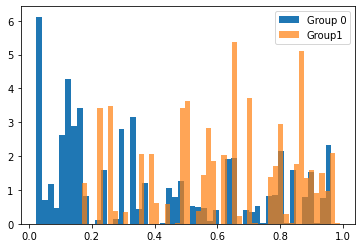

Epoch: 0 -- Training Loss:  tensor(0.6092, grad_fn=<DivBackward0>)  Val Loss:  tensor(0.5798, grad_fn=<DivBackward0>)
Epoch: 100 -- Training Loss:  tensor(0.5600, grad_fn=<DivBackward0>)  Val Loss:  tensor(0.5694, grad_fn=<DivBackward0>)
tensor(0.5265, grad_fn=<MeanBackward0>)
tensor(0.4490, grad_fn=<MeanBackward0>)
(tensor([0.7652]), tensor([0.7458]), tensor([0.7857]))


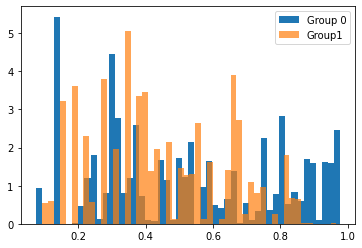

Epoch: 0 -- Training Loss:  tensor(0.5850, grad_fn=<DivBackward0>)  Val Loss:  tensor(0.6008, grad_fn=<DivBackward0>)
Epoch: 100 -- Training Loss:  tensor(0.5762, grad_fn=<DivBackward0>)  Val Loss:  tensor(0.6058, grad_fn=<DivBackward0>)
tensor(0.5386, grad_fn=<MeanBackward0>)
tensor(0.4599, grad_fn=<MeanBackward0>)
(tensor([0.7573]), tensor([0.7580]), tensor([0.7566]))


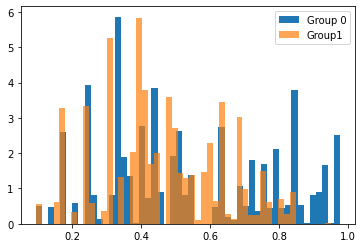

Epoch: 0 -- Training Loss:  tensor(0.5879, grad_fn=<DivBackward0>)  Val Loss:  tensor(0.6350, grad_fn=<DivBackward0>)
Epoch: 100 -- Training Loss:  tensor(0.5838, grad_fn=<DivBackward0>)  Val Loss:  tensor(0.6326, grad_fn=<DivBackward0>)
tensor(0.5408, grad_fn=<MeanBackward0>)
tensor(0.4612, grad_fn=<MeanBackward0>)
(tensor([0.7576]), tensor([0.7634]), tensor([0.7519]))


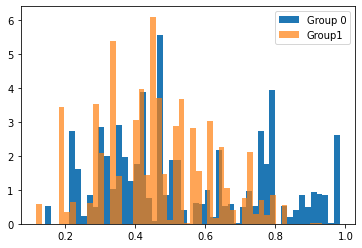

Epoch: 0 -- Training Loss:  tensor(0.5902, grad_fn=<DivBackward0>)  Val Loss:  tensor(0.6527, grad_fn=<DivBackward0>)
Epoch: 100 -- Training Loss:  tensor(0.5861, grad_fn=<DivBackward0>)  Val Loss:  tensor(0.6576, grad_fn=<DivBackward0>)
tensor(0.5379, grad_fn=<MeanBackward0>)
tensor(0.4797, grad_fn=<MeanBackward0>)
(tensor([0.7659]), tensor([0.7677]), tensor([0.7641]))


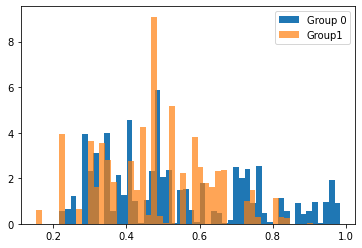

In [71]:
#training loop
epochs = 200
model = Model(8)
optimizer = torch.optim.SGD(model.parameters(), lr=0.1, momentum=5e-4)
for r in range(5):
    loss = SP_loss(lam=r, eps=0.01)
    model.train()

    for i in range(epochs):
        trainloss_total = []
        valloss_total = []
        model.train(True)
        for j, (x_train, y_train, cf_train) in enumerate(trainloader):
            output = model(x_train)
            output0 = output[torch.where(x_train[:,0] == 0)]
            output1 = output[torch.where(x_train[:,0] == 1)]
            target0 = y_train[torch.where(x_train[:,0] == 0)]
            target1 = y_train[torch.where(x_train[:,0] == 1)]
            #cf_output = torch.hstack([model(counter_data) for counter_data in cf_train])
            error = loss(output0, target0, output1, target1)
            optimizer.zero_grad()
            error.backward()
            optimizer.step()
            trainloss_total.append(error)

        if (i % 100) == 0:
            model.train(False)
            for k, (x_test, y_test, cf_test) in enumerate(testloader):
                out_test = model(x_test)
                output0_test = out_test[torch.where(x_test[:,0] == 0)]
                output1_test = out_test[torch.where(x_test[:,0] == 1)]
                target0_test = y_test[torch.where(x_test[:,0] == 0)]
                target1_test = y_test[torch.where(x_test[:,0] == 1)]
                #cf_out_test = torch.hstack([model(counter_data_test) for counter_data_test in cf_test])
                error = loss(output0_test, target0_test, output1_test, target1_test)
                valloss_total.append(error)

            print('Epoch: {} -- Training Loss: '.format(i), sum(trainloss_total)/len(trainloss_total),\
                " Val Loss: ", sum(valloss_total)/len(valloss_total))
        
    gp0 = test.data.values[:,:-1][test.data.values[:,0] == 0]
    gp1 = test.data.values[:,:-1][test.data.values[:,0] == 1]
    out_0 = model(torch.from_numpy(gp0).float())
    out_1 = model(torch.from_numpy(gp1).float())
    print(torch.mean(out_0))
    print(torch.mean(out_1))
    print(model.evalmodified(testloader))
    plt.hist(out_0.detach().numpy(), bins=50, density=True, alpha = 1, label='Group 0')
    plt.hist(out_1.detach().numpy(), bins=50, density=True, alpha = 0.7, label='Group1')
    plt.legend(loc='upper right')
    plt.show()

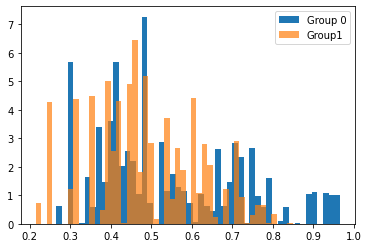

In [69]:
plt.hist(out_0.detach().numpy(), bins=50, density=True, alpha = 1, label='Group 0')
plt.hist(out_1.detach().numpy(), bins=50, density=True, alpha = 0.7, label='Group1')
plt.legend(loc='upper right')
plt.show()

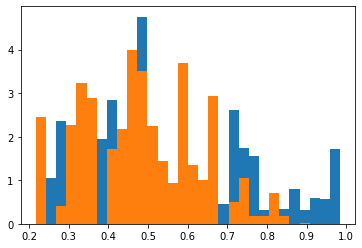

In [112]:
value0 = plt.hist(out_0.detach().numpy(), bins=30, density=True)
value1 = plt.hist(out_1.detach().numpy(), bins=value0[1], density=True)

In [5]:
cfs_read = []
precs_read = []
recalls_read = []
f1s_read = []

for r in range(31):
    with open('./script_results/examp5_63_adj_condensate/cf_accus'+str(r)+'.txt') as f1:
        cft_list = np.loadtxt(f1)

    with open('./script_results/examp5_63_adj_condensate/precs'+str(r)+'.txt') as f2:
        precs_list = np.loadtxt(f2)

    with open('./script_results/examp5_63_adj_condensate/recall'+str(r)+'.txt') as f3:
        recalls_list = np.loadtxt(f3)
    
    with open('./script_results/examp5_63_adj_condensate/f1'+str(r)+'.txt') as f4:
        f1s_list = np.loadtxt(f4)
    
    cfs_read.append(cft_list)
    precs_read.append(precs_list)
    recalls_read.append(recalls_list)
    f1s_read.append(f1s_list)

In [7]:
import plotly.graph_objs as go

lambdas = np.arange(start=0,stop=7, step=0.2).tolist()
precs_mean = np.nanmean(np.array(precs_read, dtype=float), axis=0)
precs_std = np.nanstd(np.array(precs_read, dtype=float), axis=0)
precs_max = (precs_mean + precs_std).tolist()
precs_min = (precs_mean - precs_std).tolist()

cf_mean_ = np.nanmean(np.array(cfs_read, dtype=float), axis=0)
cf_std_ = np.nanstd(np.array(cfs_read, dtype=float), axis=0)
cf_max_ = (cf_mean_ + cf_std_).tolist()
cf_min_ = (cf_mean_ - cf_std_).tolist()

recalls_mean_ = np.nanmean(np.array(recalls_read, dtype=float), axis=0)
recalls_std_ = np.nanstd(np.array(recalls_read, dtype=float), axis=0)
recalls_max_ = (recalls_mean_ + recalls_std_).tolist()
recalls_min_ = (recalls_mean_ - recalls_std_).tolist()

f1s_mean_ = np.nanmean(np.array(f1s_read, dtype=float), axis=0)
f1s_std_ = np.nanstd(np.array(f1s_read, dtype=float), axis=0)
f1s_max_ = (f1s_mean_ + f1s_std_).tolist()
f1s_min_ = (f1s_mean_ - f1s_std_).tolist()


fig = go.Figure([
    go.Scatter(
        x=lambdas,
        y=cf_mean_,
        line=dict(color='rgb(100,0,0)'),
        mode='lines',
        name=' Mean Counterfactual Accuracy',
    ),
    go.Scatter(
        x=lambdas+lambdas[::-1], # x, then x reversed
        y=cf_max_ + cf_min_[::-1], # upper, then lower reversed
        fill='toself',
        fillcolor='rgba(100,0,0,0.2)',
        line=dict(color='rgba(255,255,255,0)'),
        hoverinfo="skip",
        showlegend=False
    ),
    go.Scatter(
        x=lambdas,
        y=precs_mean,
        line=dict(color='rgb(0,100,80)'),
        mode='lines',
        name='Mean Precision',
    ),
    go.Scatter(
        x=lambdas+lambdas[::-1], # x, then x reversed
        y=precs_max + precs_min[::-1], # upper, then lower reversed
        fill='toself',
        fillcolor='rgba(0,100,80,0.2)',
        line=dict(color='rgba(255,255,255,0)'),
        hoverinfo="skip",
        showlegend=False
    )
])
fig.update_layout(
    xaxis_title='Lambdas',
    title='Example 1: Model Performance',
    hovermode="x"
)
fig.show()

## Random Graph

In [4]:
adj = random_graph(n_var_lim=50)
adj

array([[ 0.,  2.,  6., ...,  0.,  0., -4.],
       [ 0.,  0.,  1., ...,  0., -0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0., -6.],
       ...,
       [ 0., -7., -6., ...,  0.,  0., -6.],
       [ 0., -2.,  0., ..., -7.,  0., -5.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.]])

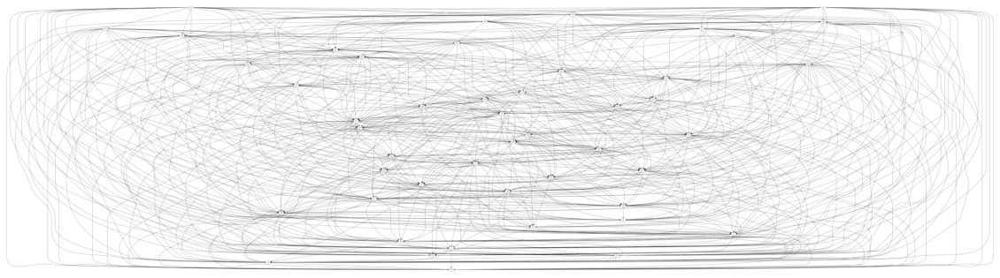

In [12]:
r_gen = CausalGenerator(adj, var_names=None, size=100000, normalize=False)
r_gen.graph_from_adjacency_matrix(directed=True)
r_gen.generate_data()

#r_gen.compute_CPDs()
#r_gen.allEdgesCausalStrength()
r_gen.generate_counterfactual_worlds('x0')

r_gen.show_graph()

In [13]:
from tqdm import tqdm

def get_closer_to(matrixes, centroid):

    norms = []
    for matrix in matrixes:
        norms.append(np.linalg.norm(matrix-centroid))

    return np.argmin(norms)

n_cluster = 3

probs = {
    'keys':['x0','x'+str(r_gen.adjency_matrix.shape[0]-1)],
    'values': (1,1),
    'prob': 0.7
}
alg ='pc'
pc_param = {'alpha' : [0.05], 'indep_test':[gsq]}
conds = [probs]
results = {}

observer = Observer(r_gen.data, 'x0')
r_sample = observer.observe(bias=conds, n_data=10000, debug=False)

    
discoverer = Discoverer()
discoverer.grid_search(r_sample.to_numpy(), alg, pc_param, r_gen.graph)
true_graph = discoverer.grid_search_results()
adj_  = graph2adj(discoverer.discovered_graphs[-1].graph)

print("Discovery process done")


0.7000205465379084
Current parameters used:  {'alpha': 0.05, 'indep_test': <function gsq at 0x7fb119cb0160>}


Depth=11, working on node 47: 100%|██████████| 48/48 [00:00<00:00, 288.46it/s]


Discovery process done


In [ ]:
#/!\ True adj 
#adj_ = (r_gen.adjency_matrix != 0).astype(float)
adj_list = handle_dcausation(adj_)
print("Nombre de graph: ",len(adj_list))

adj_list = [adj for adj in adj_list if not check_cycles(adj)[0]]
scm_fitter = [LinearSCM(adj) for adj in adj_list]
scms = [fitter.fit(r_sample) for fitter in scm_fitter]

if len(scms) > 7:
    flat = [scm.flatten() for scm in scms]
    kmeans = KMeans(n_clusters=n_cluster, random_state=0).fit(flat)
    centroids = [center.reshape(adj.shape) for center in kmeans.cluster_centers_]
    real_scms = [scms[get_closer_to(scms, centroid)] for centroid in centroids]

counterfactuals = []
print("Number of usable graphs ",len(scms))

for idx, scm in enumerate(real_scms):
    #Empty
    empty = pd.DataFrame(0, index=range(len(r_sample)), columns=r_sample.columns)
    new_gen = CausalGenerator(adjency_matrix=scm, normalize=True)
    new_gen.graph_from_adjacency_matrix(directed=True)
    print("Init Data: ",str(idx))
    new_gen.generate_data(store=True)
    #ynew_gen.noise = scm_fitter[idx].noises[:,sample.index]
    r_sample = r_sample.reset_index(drop=True)
    new_gen.noise = scm_fitter[idx].noises[:,r_sample.index]
    new_gen.data = r_sample
    print("CF Data: ",str(idx))
    new_gen.generate_counterfactual_worlds('x0')
    #counterfactual = pd.concat([new_gen.counterfactual_world_1.iloc[sample[sample['x0'] == 0].index], new_gen.counterfactual_world_0.iloc[sample[sample['x0'] == 1].index]], axis=0)
    empty.update(new_gen.counterfactual_world_1.iloc[r_sample[r_sample['x0'] == 0].index])
    empty.update(new_gen.counterfactual_world_0.iloc[r_sample[r_sample['x0'] == 1].index])
    counterfactuals.append(empty)

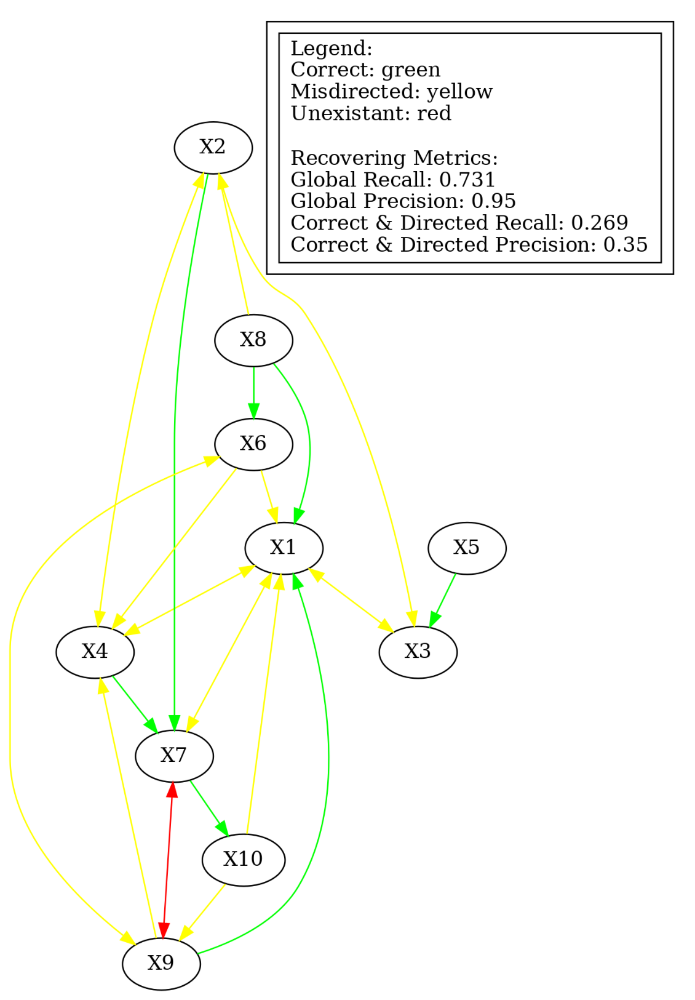

In [63]:
show(discoverer.discovered_graphs_pyd[0])

In [59]:
#Train test split
X_train, X_test, y_train, y_test= train_test_split(r_sample.iloc[:,:-1], r_sample.iloc[:,-1], test_size=0.2)
counterfactuals_train = [counterfactual.iloc[X_train.index] for counterfactual in counterfactuals]
counterfactuals_test = [counterfactual.iloc[X_test.index] for counterfactual in counterfactuals]

#Datasets
trainset = dataset(X_train.values, y_train.values, counterfactuals_train)
testset = dataset(X_test.values, y_test.values, counterfactuals_test)

#DataLoader
trainloader = DataLoader(trainset, batch_size=128, shuffle=False)
testloader = DataLoader(testset, batch_size=128, shuffle=False)

In [60]:
#training loop for curve plotting
import torch

cf_accus = []
f1s = []
precisions = []
recalls = []
lambdas = np.arange(start=0,stop=7, step=0.2)
preds_world_2 = []

fouts_0 = []
fouts_1 = []

for lam in tqdm(lambdas):

    epochs = 200
    model = Model((r_gen.adjency_matrix.shape[0]-1))
    optimizer = torch.optim.SGD(model.parameters(), lr=0.1, momentum=5e-4)
    loss = MWCF_loss(lam=lam, eps=0.1)
    model.train()
    for i in range(epochs):
        trainloss_total = []
        valloss_total = []
        model.train(True)
        for j, (x_train, y_train, cf_train) in enumerate(trainloader):
            output = model(x_train)
            cf_output = torch.hstack([model(counter_data) for counter_data in cf_train])
            error = loss(output, y_train, cf_output)
            optimizer.zero_grad()
            error.backward()
            optimizer.step()
            trainloss_total.append(error)

        if (i % 100) == 0:
            model.train(False)
            for k, (x_test, y_test, cf_test) in enumerate(testloader):
                out_test = model(x_test)
                cf_out_test = torch.hstack([model(counter_data_test) for counter_data_test in cf_test])
                error = loss(out_test, y_test, cf_out_test)
                valloss_total.append(error)

    cf0 = torch.from_numpy(r_gen.counterfactual_world_0.values[:,:-1]).float()
    cf1 = torch.from_numpy(r_gen.counterfactual_world_1.values[:,:-1]).float()
    gp0 = r_gen.data.values[:,:-1][r_gen.data.values[:,0] == 0]
    gp1 = r_gen.data.values[:,:-1][r_gen.data.values[:,0] == 1]
    
    f1, precision, recall = model.evalmodified(testloader)
    cf_accu = model.eval_cf(cf0,cf1)

    fouts_0.append(model(torch.from_numpy(gp0).float()))
    fouts_1.append(model(torch.from_numpy(gp1).float()))

    cf_accus.append(cf_accu)
    f1s.append(f1)
    precisions.append(precision)
    recalls.append(recall)



100%|██████████| 35/35 [37:37<00:00, 64.49s/it]


[tensor([0.7206]), tensor([0.9593]), tensor([0.9740]), tensor([0.9740]), tensor([0.9868]), tensor([0.9868]), tensor([0.9881]), tensor([0.9987]), tensor([0.9807]), tensor([1.]), tensor([0.9693]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([0.9853]), tensor([0.9998]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.]), tensor([1.])]


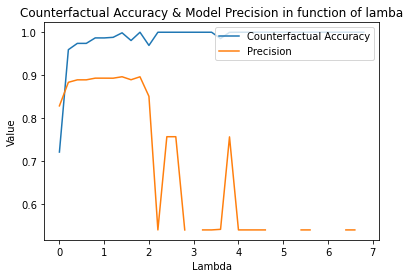

In [61]:
print(cf_accus)
plt.plot(lambdas[:len(cf_accus)],[cf_accu.numpy() for cf_accu in cf_accus], label='Counterfactual Accuracy')
plt.plot(lambdas[:len(cf_accus)],[precision.numpy() for precision in precisions], label='Precision')
plt.title('Counterfactual Accuracy & Model Precision in function of lamba')
plt.xlabel('Lambda')
plt.ylabel('Value')
plt.legend(loc='upper right')
plt.show()

## Random Graph + Condensation

### Data Generation

In [3]:
adj = random_graph(n_var_lim=100)

In [4]:
print(adj.shape)

(55, 55)


In [6]:
np.save('adj_55.npy',adj)

In [3]:
adj = np.load('adj_61.npy')

In [4]:
r_gen = CausalGenerator(adj, var_names=None, size=100000, normalize=False)
r_gen.graph_from_adjacency_matrix(directed=True)
r_gen.generate_data()

#r_gen.compute_CPDs()
#r_gen.allEdgesCausalStrength()
r_gen.generate_counterfactual_worlds('x0')

#r_gen.show_graph()

### Discovery Process

In [5]:
from tqdm import tqdm

def get_closer_to(matrixes, centroid):

    norms = []
    for matrix in matrixes:
        norms.append(np.linalg.norm(matrix-centroid))

    return np.argmin(norms)

n_cluster = 3

probs = {
    'keys':['x0','x'+str(r_gen.adjency_matrix.shape[0]-1)],
    'values': (1,1),
    'prob': 0.7
}
alg ='pc'
pc_param = {'alpha' : [0.05], 'indep_test':[gsq]}
conds = [probs]
results = {}

observer = Observer(r_gen.data, 'x0')
r_sample = observer.observe(bias=conds, n_data=10000, debug=False)

    
discoverer = Discoverer()
discoverer.grid_search(r_sample.to_numpy(), alg, pc_param, r_gen.graph)
true_graph = discoverer.grid_search_results()
adj_  = graph2adj(discoverer.discovered_graphs[-1].graph)

print("Discovery process done")


0.7001588562351072
Current parameters used:  {'alpha': 0.05, 'indep_test': <function gsq at 0x7fbbc8aeaee0>}


Depth=12, working on node 60: 100%|██████████| 61/61 [00:00<00:00, 295.50it/s]


Discovery process done


### Condensation + Extract Graphs

1

In [15]:
#Faut vérifier que je garde bien le paramètre sensible et l'output
coord = [(x,y) for x, y in zip(np.where(adj_ == 2)[0],np.where(adj_ == 2)[1])]
for c in coord:
    adj_[c] = 1

G = nx.DiGraph(adj_)
G_ = nx.condensation(G)

val = list(G_.graph['mapping'].values())
keys = list(G_.graph['mapping'].keys())

cols_order = [keys[val.index(i)] for i in val]
indexes = np.unique(cols_order, return_index=True)[1]
cols_ordered = [cols_order[index] for index in sorted(indexes)]


2

In [6]:
#Faut vérifier que je garde bien le paramètre sensible et l'output
coord = [(x,y) for x, y in zip(np.where(adj_ == 2)[0],np.where(adj_ == 2)[1])]
for c in coord:
    adj_[c] = 1

G = nx.DiGraph(adj_)
G_ = nx.condensation(G)

val = list(G_.graph['mapping'].values())
keys = list(G_.graph['mapping'].keys())

cols_order = []
for i in val:
    indexes_i = list(np.where(np.array(val) == i)[0])
    inner_key = [keys[id_i] for id_i in indexes_i]
    if 0 in inner_key:
        cols_order.append(0)
    elif (adj_.shape[0]-1) in inner_key:
        cols_order.append((adj_.shape[0]-1))
    else:
        cols_order.append(inner_key[0])

indexes = np.unique(cols_order, return_index=True)[1]
cols_ordered = [cols_order[index] for index in sorted(indexes)]


3

In [12]:
val

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26]

In [9]:
inner_key

[6,
 8,
 10,
 12,
 14,
 15,
 19,
 20,
 21,
 22,
 24,
 25,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 37,
 40,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 51,
 52,
 53,
 55,
 57]

In [15]:
#Faut vérifier que je garde bien le paramètre sensible et l'output
coord = [(x,y) for x, y in zip(np.where(adj_ == 2)[0],np.where(adj_ == 2)[1])]
for c in coord:
    adj_[c] = 1

G = nx.DiGraph(adj_)
G_ = nx.condensation(G)

val = list(G_.graph['mapping'].values())
keys = list(G_.graph['mapping'].keys())

list_c_ord = []
cols_order = []
list_c_ord.append(cols_order)
for i in val:
    print(i)
    print(list_c_ord)
    indexes_i = list(np.where(np.array(val) == i)[0])
    inner_key = [keys[id_i] for id_i in indexes_i]
    print(inner_key)
    if 0 in inner_key:
        for c_ord in list_c_ord:
            c_ord.append(0)
    elif (adj_.shape[0]-1) in inner_key:
        for c_ord in list_c_ord:
            c_ord.append((adj_.shape[0]-1))
    else:
        if len(inner_key) >0:
            length = len(list_c_ord)
            for j in range(length):
                c_ord = list_c_ord.pop(j)
                for el in inner_key:
                    print(el)
                    print(list_c_ord)
                    c_ord.append(el)
                    list_c_ord.append(c_ord)
        else:
            for c_ord in list_c_ord:
                c_ord.append(inner_key[0])

indexes = np.unique(cols_order, return_index=True)[1]
cols_ordered = [cols_order[index] for index in sorted(indexes)]


0
[[]]
[39]
39
1
[[39]]
[49]
49
2
[[39, 49]]
[60]
3
[[39, 49, 60]]
[54]
54
4
[[39, 49, 60, 54]]
[50]
50
5
[[39, 49, 60, 54, 50]]
[59]
59
6
[[39, 49, 60, 54, 50, 59]]
[41]
41
7
[[39, 49, 60, 54, 50, 59, 41]]
[56]
56
8
[[39, 49, 60, 54, 50, 59, 41, 56]]
[36]
36
9
[[39, 49, 60, 54, 50, 59, 41, 56, 36]]
[6, 8, 10, 12, 14, 15, 19, 20, 21, 22, 24, 25, 27, 28, 29, 30, 31, 32, 33, 34, 35, 37, 40, 42, 43, 44, 45, 46, 47, 48, 51, 52, 53, 55, 57]
6
8
10
12
14
15
19
20
21
22
24
25
27
28
29
30
31
32
33
34
35
37
40
42
43
44
45
46
47
48
51
52
53
55
57
9
[[39, 49, 60, 54, 50, 59, 41, 56, 36, 6, 8, 10, 12, 14, 15, 19, 20, 21, 22, 24, 25, 27, 28, 29, 30, 31, 32, 33, 34, 35, 37, 40, 42, 43, 44, 45, 46, 47, 48, 51, 52, 53, 55, 57], [39, 49, 60, 54, 50, 59, 41, 56, 36, 6, 8, 10, 12, 14, 15, 19, 20, 21, 22, 24, 25, 27, 28, 29, 30, 31, 32, 33, 34, 35, 37, 40, 42, 43, 44, 45, 46, 47, 48, 51, 52, 53, 55, 57], [39, 49, 60, 54, 50, 59, 41, 56, 36, 6, 8, 10, 12, 14, 15, 19, 20, 21, 22, 24, 25, 27, 28, 29, 30, 31,

KeyboardInterrupt: 

In [7]:
list_c_ord

[[39,
  49,
  49,
  60,
  60,
  60,
  60,
  54,
  54,
  54,
  54,
  50,
  50,
  50,
  50,
  50,
  50,
  50,
  50,
  59,
  59,
  59,
  59,
  59,
  59,
  59,
  59,
  59,
  59,
  59,
  59,
  59,
  59,
  59,
  59,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  41,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  56,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36,
  36

In [7]:
r_reindex = []
r_reindex.append(list(G_.nodes)[cols_ordered.index(0)])

for element in cols_ordered:
    if (element != adj_.shape[0]-1) & (element != 0):
        print(element, cols_ordered.index(element))
        r_reindex.append(list(G_.nodes)[cols_ordered.index(element)])

r_reindex.append(list(G_.nodes)[cols_ordered.index((adj_.shape[0]-1))])

55 0
49 1
54 2
57 3
50 4
51 5
40 6
53 7
58 8
48 9
59 10
35 11
39 12
46 13
56 14
44 15
37 16
36 17
30 18
52 19
34 20
41 21
42 22
32 23
18 24
47 25
33 26
29 27
28 28
43 29
25 30
2 31
19 32
12 33
24 34
22 35
15 36
31 37
38 38
8 39
17 40
21 42
3 43
7 44
1 45
4 46
20 47
5 48
6 49
14 50
9 51
13 52
11 53
16 54


In [8]:
cond_adj = np.array(nx.adjacency_matrix(G_, nodelist=r_reindex).todense())

/tmp/ipykernel_32373/825074926.py:1: FutureWarning: adjacency_matrix will return a scipy.sparse array instead of a matrix in Networkx 3.0.
  cond_adj = np.array(nx.adjacency_matrix(G_, nodelist=r_reindex).todense())


In [9]:
r_col = [cols_ordered[i] for i in r_reindex]

In [10]:
r_sample_condensed = r_sample[['x'+str(col) for col in r_col]]
r_sample_condensed.columns = ['x'+str(i) for i in range(len(r_sample_condensed.columns))]
fitter = LinearSCM(cond_adj)
scm = fitter.fit(r_sample_condensed)

/home/maxence/anaconda3/envs/causal-learn-test/lib/python3.9/site-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/maxence/anaconda3/envs/causal-learn-test/lib/python3.9/site-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/maxence/anaconda3/envs/causal-learn-test/lib/python3.9/site-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/maxence/anaconda3/envs/causal-learn-test/lib/python3.9/site-packages/sklearn/utils/validation.py:993: D

In [11]:
counterfactuals = []
empty = pd.DataFrame(0, index=range(len(r_sample_condensed)), columns=r_sample_condensed.columns)
new_gen = CausalGenerator(adjency_matrix=scm, normalize=True)
new_gen.graph_from_adjacency_matrix(directed=True)
print("Init Data: ")
new_gen.generate_data(store=True)
#ynew_gen.noise = scm_fitter[idx].noises[:,sample.index]
r_sample_condensed = r_sample_condensed.reset_index(drop=True)
new_gen.noise = fitter.noises[:,r_sample_condensed.index]
new_gen.data = r_sample_condensed
print("CF Data: ")
new_gen.generate_counterfactual_worlds('x0')
#counterfactual = pd.concat([new_gen.counterfactual_world_1.iloc[sample[sample['x0'] == 0].index], new_gen.counterfactual_world_0.iloc[sample[sample['x0'] == 1].index]], axis=0)
empty.update(new_gen.counterfactual_world_1.iloc[r_sample_condensed[r_sample_condensed['x0'] == 0].index])
empty.update(new_gen.counterfactual_world_0.iloc[r_sample_condensed[r_sample_condensed['x0'] == 1].index])
counterfactuals.append(empty)

Init Data: 
CF Data: 


In [12]:
#Train test split
X_train, X_test, y_train, y_test= train_test_split(r_sample_condensed.iloc[:,:-1], r_sample_condensed.iloc[:,-1], test_size=0.2)
counterfactuals_train = [counterfactual.iloc[X_train.index] for counterfactual in counterfactuals]
counterfactuals_test = [counterfactual.iloc[X_test.index] for counterfactual in counterfactuals]

#Datasets
trainset = dataset(X_train.values, y_train.values, counterfactuals_train)
testset = dataset(X_test.values, y_test.values, counterfactuals_test)

#DataLoader
trainloader = DataLoader(trainset, batch_size=128, shuffle=False)
testloader = DataLoader(testset, batch_size=128, shuffle=False)

In [2]:
#training loop for curve plotting
import torch

cf_accus = []
f1s = []
precisions = []
recalls = []
lambdas = np.arange(start=0,stop=7, step=0.2)
preds_world_2 = []

fouts_0 = []
fouts_1 = []

for lam in tqdm(lambdas):

    epochs = 200
    model = Model(scm.shape[0]-1)
    optimizer = torch.optim.SGD(model.parameters(), lr=0.1, momentum=5e-4)
    loss = MWCF_loss(lam=lam, eps=0.1)
    model.train()
    for i in range(epochs):
        trainloss_total = []
        valloss_total = []
        model.train(True)
        for j, (x_train, y_train, cf_train) in enumerate(trainloader):
            output = model(x_train)
            cf_output = torch.hstack([model(counter_data) for counter_data in cf_train])
            error = loss(output, y_train, cf_output)
            optimizer.zero_grad()
            error.backward()
            optimizer.step()
            trainloss_total.append(error)

        if (i % 100) == 0:
            model.train(False)
            for k, (x_test, y_test, cf_test) in enumerate(testloader):
                out_test = model(x_test)
                cf_out_test = torch.hstack([model(counter_data_test) for counter_data_test in cf_test])
                error = loss(out_test, y_test, cf_out_test)
                valloss_total.append(error)

    cf0 = torch.from_numpy(r_gen.counterfactual_world_0[['x'+str(i) for i in r_col[:-1]]].values).float()
    cf1 = torch.from_numpy(r_gen.counterfactual_world_1[['x'+str(i) for i in r_col[:-1]]].values).float()
    gp0 = r_gen.data[['x'+str(i) for i in r_col[:-1]]].values[r_gen.data.values[:,0] == 0]
    gp1 = r_gen.data[['x'+str(i) for i in r_col[:-1]]].values[r_gen.data.values[:,0] == 1]
    
    f1, precision, recall = model.evalmodified(testloader)
    cf_accu = model.eval_cf(cf0,cf1)

    fouts_0.append(model(torch.from_numpy(gp0).float()))
    fouts_1.append(model(torch.from_numpy(gp1).float()))

    cf_accus.append(cf_accu)
    f1s.append(f1)
    precisions.append(precision)
    recalls.append(recall)

NameError: name 'np' is not defined

[tensor([0.6244]), tensor([0.7557]), tensor([0.7733]), tensor([0.7617]), tensor([0.7701]), tensor([0.7775]), tensor([0.7782]), tensor([0.7866]), tensor([0.7719]), tensor([0.7739]), tensor([0.7952]), tensor([0.7846]), tensor([0.7772]), tensor([0.7827]), tensor([0.7768]), tensor([0.7842]), tensor([0.7748]), tensor([0.7861]), tensor([0.7738]), tensor([0.7851]), tensor([0.7709]), tensor([0.7727]), tensor([0.7869]), tensor([0.7807]), tensor([0.7781]), tensor([0.7738]), tensor([0.7782]), tensor([0.7887]), tensor([0.7883]), tensor([0.7869]), tensor([0.7886]), tensor([0.9306]), tensor([1.]), tensor([1.]), tensor([1.])]


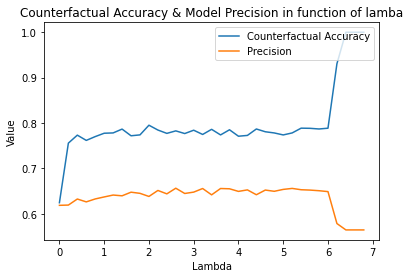

In [14]:
print(cf_accus)
plt.plot(lambdas[:len(cf_accus)],[cf_accu.numpy() for cf_accu in cf_accus], label='Counterfactual Accuracy')
plt.plot(lambdas[:len(cf_accus)],[precision.numpy() for precision in precisions], label='Precision')
plt.title('Counterfactual Accuracy & Model Precision in function of lamba')
plt.xlabel('Lambda')
plt.ylabel('Value')
plt.legend(loc='upper right')
plt.show()

In [46]:
r_gen.counterfactual_world_0[['x'+str(i) for i in r_col[:-1]]].values

array([[0, 1, 0, ..., 0, 1, 0],
       [0, 1, 0, ..., 1, 0, 1],
       [0, 1, 1, ..., 0, 1, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 1, 0, ..., 1, 0, 1],
       [0, 1, 0, ..., 0, 0, 0]])